This notebook calculates spectral-angular distribution of the number of photons emitted by a single electron in the undulator per one pass

In [1]:
import numpy as np
from wigrad import Wiggler, WigglerRadiationSimulator

In [2]:
wiggler = Wiggler(K_peak=1, N_periods=10, lambda_wiggler_m=0.055)
x_max = 0.00726  # rad
y_max = x_max  # rad
n_x = 400  # after using symmetries the size will be twice that
n_y = 400  # after using symmetries the size will be twice that
n_l = 100
l_min = 0.4  # um
l_max = 1.8  # um
x_step = x_max/(n_x-1)
y_step = y_max/(n_y-1)
l_step = (l_max-l_min)/(n_l-1)
# this mesh is only for positive theta_x and theta_y, the results will be extended later using symmetries (two mirror symmetries: along y-axis and along x-axis)
mesh = (np.linspace(x_step/2, x_max+x_step/2, n_x),
        np.linspace(y_step/2, y_max+y_step/2, n_y),
        np.linspace(l_min, l_max, n_l))
wr_sim = WigglerRadiationSimulator(
    wiggler,
    mesh,
    gamma=100/0.511,
    harmonics=[1,2,3],  # harmonics to be calculated have to be specified
    aperture=None,  # as of now the only other option is 'ellipse'
    only_calc_sum_of_both_polarizations=False,  # if False, then both polarizations are calculated separately. True can be used when you only need sum of both polarizations, and you calculate it on a very fine mesh. This will save some memory.
    spectral_transmission=None  # you can provide transmission of filters, QE of detector here, 1D array of the same length as the wavelengths array
    )

In the cell below, spectral-angular distribution of the number of emitted photons is calculated on the mesh with postive $\theta_x$ and $\theta_y$ only (one quarter).

In [3]:
wr_sim.calc_photon_flux_on_meshgrid()

Below the results calculated only in the quarter with postive $\theta_x$ and $\theta_y$ are extended to all four quarters. Note that the meshgrid for $\theta_x$, $\theta_y$ is extended too (the attributes x_range, y_range, x_2D, y_2D of wr_sim).

In [4]:
wr_sim.extend_results_using_symmetries()

The results calculated on the 3D mesh can be obtained by
`wr_sim.get_photon_flux_3D(polarization)`, where `polarization` can be 'x', 'y', or 'sum'. Meshgrid for $\theta_x$ and $\theta_y$ can be obtained by `wr_sim.x_2D` and `wr_sim.y_2D`, respectively.

To get the numeric data for the plots below, replace 'show' by 'get'. For exampple, replace
`wr_sim.show_angular_distribution(polarization='x', index_of_lambda=14)` by `wr_sim.get_angular_distribution(polarization='x', index_of_lambda=14)`

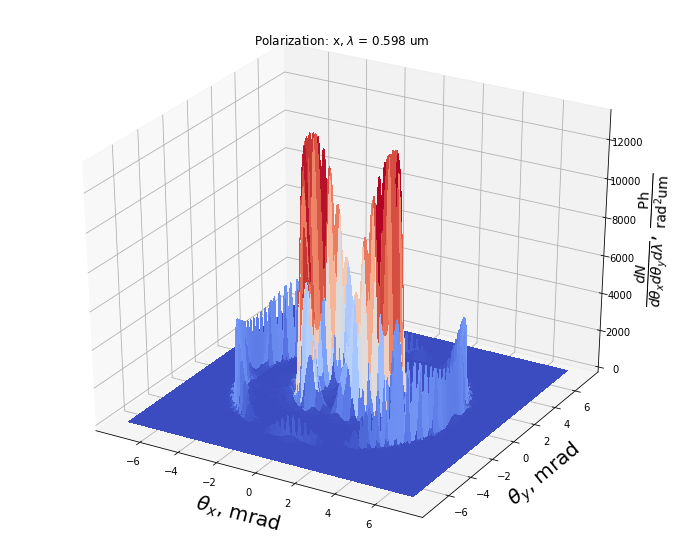

In [5]:
wr_sim.show_angular_distribution(polarization='x', index_of_lambda=14)

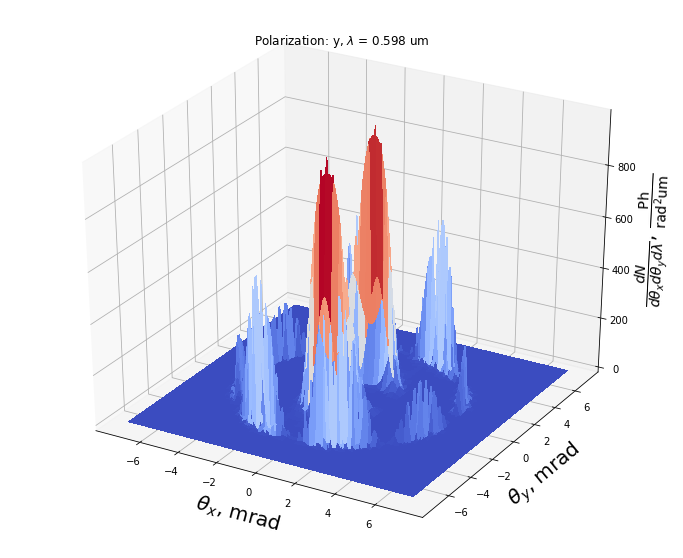

In [6]:
wr_sim.show_angular_distribution(polarization='y', index_of_lambda=14)

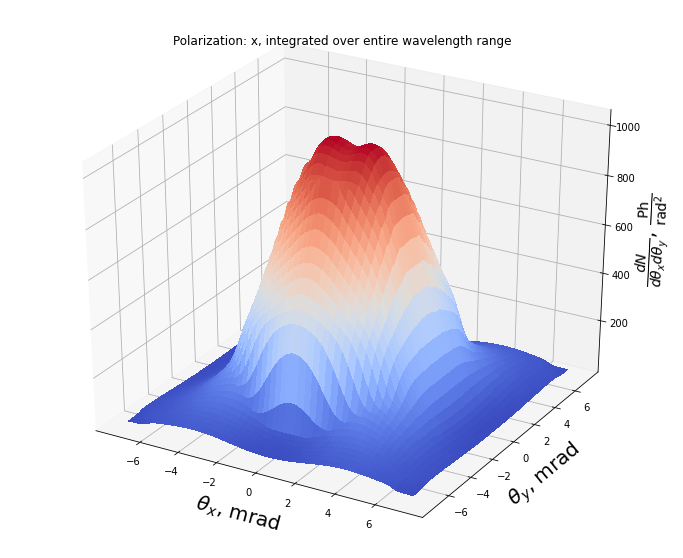

In [7]:
wr_sim.show_angular_distribution(polarization='x')

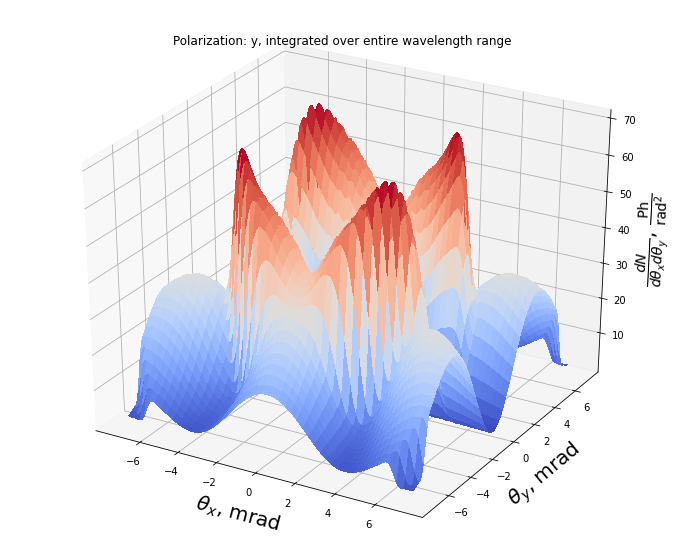

In [8]:
wr_sim.show_angular_distribution(polarization='y')

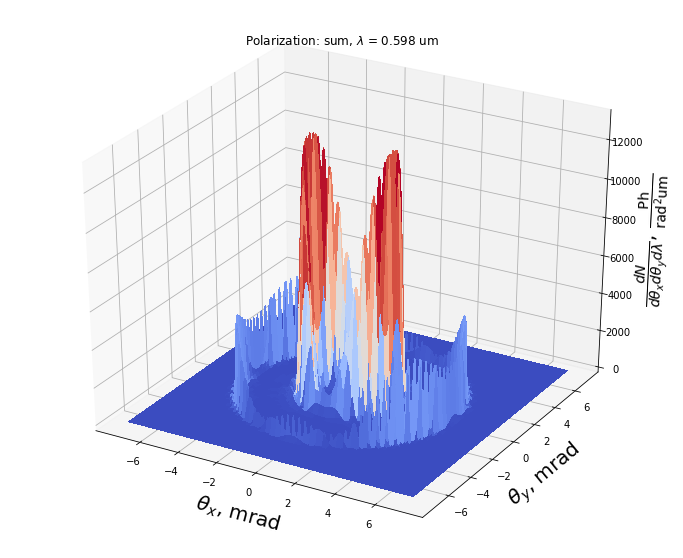

In [9]:
wr_sim.show_angular_distribution(index_of_lambda=14)

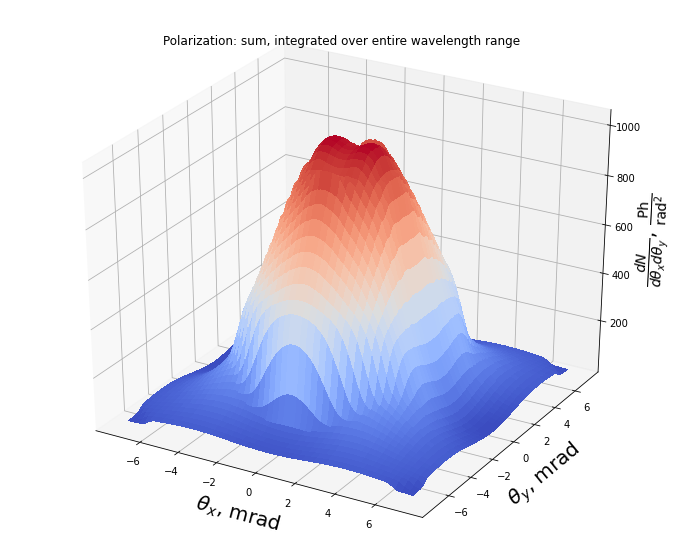

In [10]:
wr_sim.show_angular_distribution(polarization='sum')

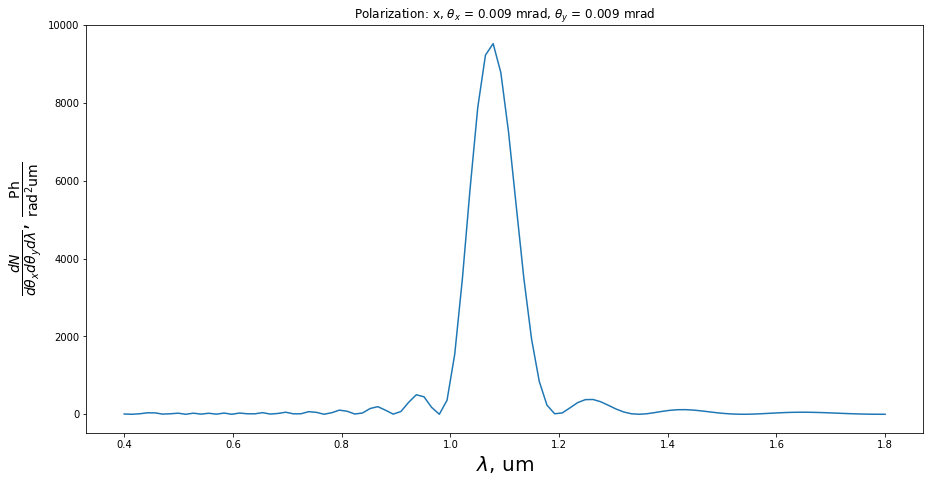

In [11]:
wr_sim.show_spectral_distribution(polarization='x', angular_indexes_tuple=(400,400))

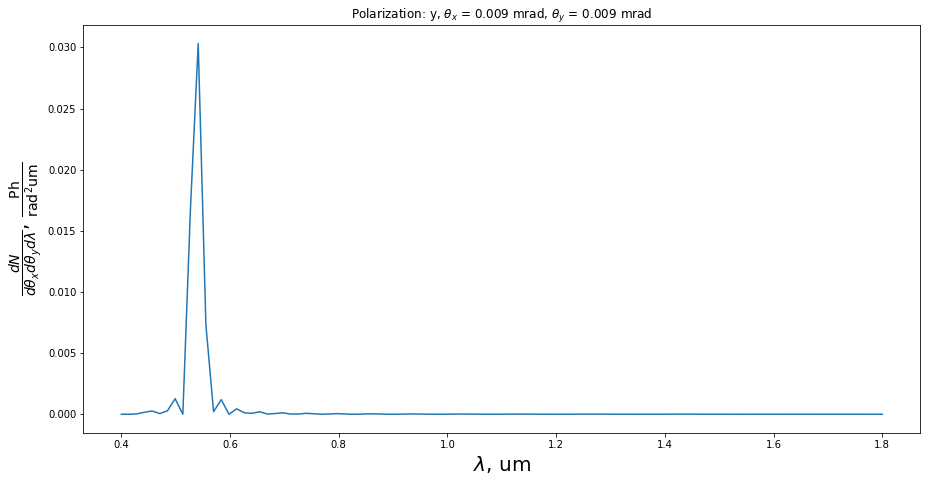

In [12]:
wr_sim.show_spectral_distribution(polarization='y', angular_indexes_tuple=(400,400))

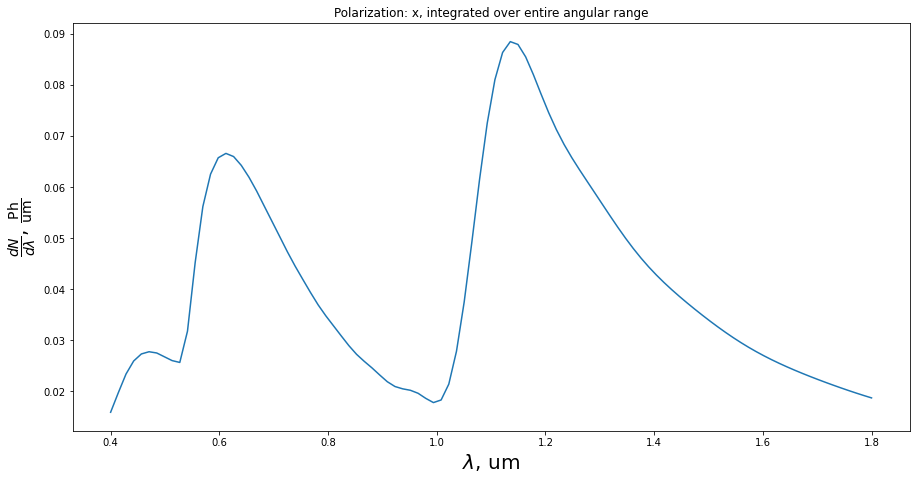

In [13]:
wr_sim.show_spectral_distribution(polarization='x')

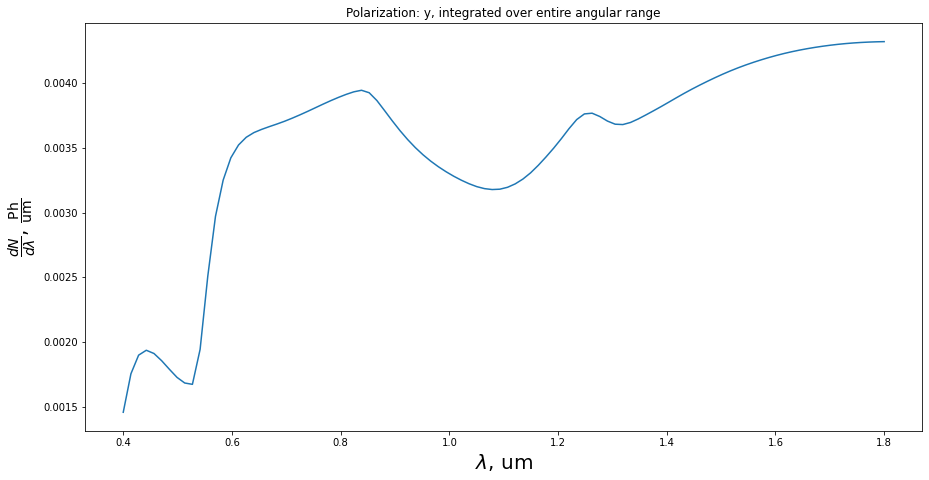

In [14]:
wr_sim.show_spectral_distribution(polarization='y')

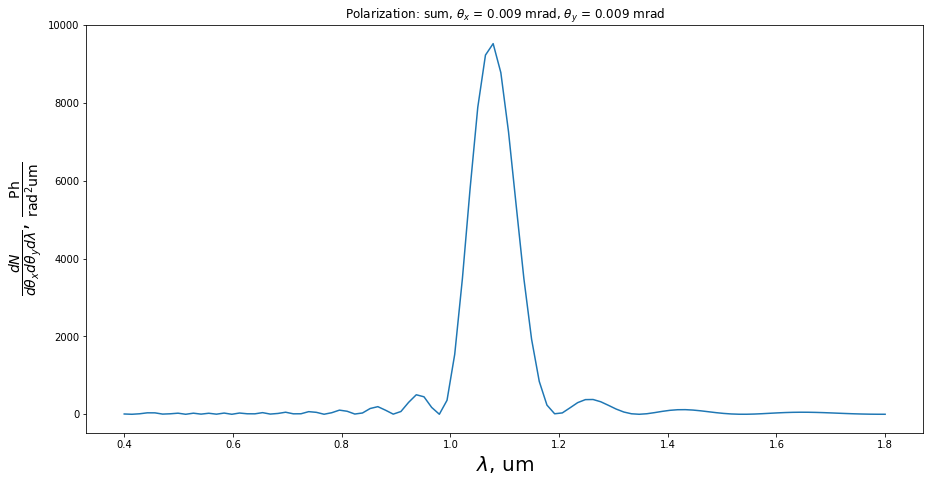

In [15]:
wr_sim.show_spectral_distribution(angular_indexes_tuple=(400,400))

The result below coincides with the SRW result, shown in Fig. 7 in https://arxiv.org/pdf/1912.06737.pdf 

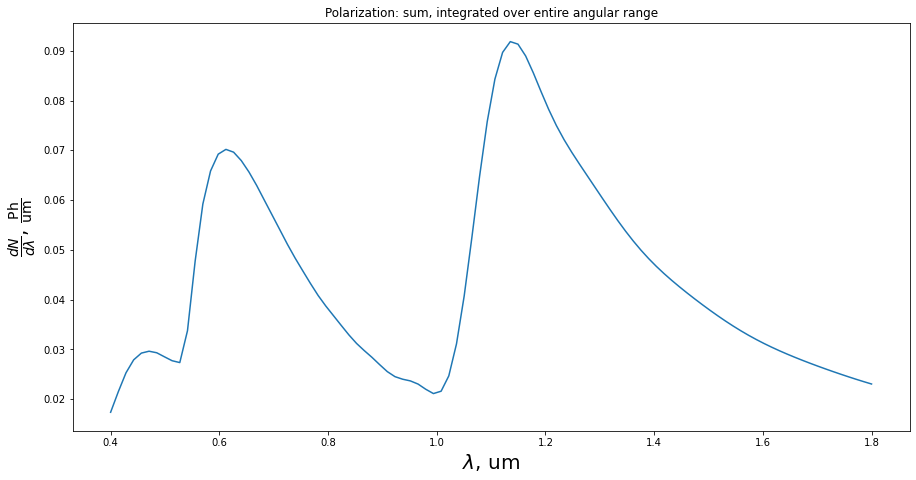

In [16]:
wr_sim.show_spectral_distribution(polarization='sum')

In [17]:
wr_sim.get_total_photon_flux(polarization='x')

0.057744672969255895

In [18]:
wr_sim.get_total_photon_flux(polarization='y')

0.005004422350618298

In [19]:
wr_sim.get_total_photon_flux(polarization='sum')

0.06274909531987416